# Style Transfer - Part 2

Image-to-image translation has been an increasingly popular topic over the last years. One example of such a task is style transfer. Style transfer algorithms in the context of art try to capture the general style of an artist or an image and apply it to one or many content pictures. As an example, think of your latest holiday pictures and try to imagine how Monet or Van Gogh would have painted the scenes. 

There are several different structures and algorithms that try to accomplish this task. They differ in their structural set-up and slightly different applications. One of the main differences is whether the style and content picture(s) are paired (image translation one-to-one, one-to-many or many-to-many). 

I will focus on one-to-one style transfer and two implementations (two separate notebooks):
* Part 1: Original style transfer by [Gatys et al (2016)](https://openaccess.thecvf.com/content_cvpr_2016/papers/Gatys_Image_Style_Transfer_CVPR_2016_paper.pdf)
* Part 2: Fast style transfer by [Johnson et al (2016)](https://arxiv.org/pdf/1603.08155.pdf)

Welcome back and let's get started with part 2. In this part I implemented a fast style transfer inspied by Johnson et al (2016). From my point of view this approach is more applicable to one-to-many translation. However, to keep things simple I will only apply it one a single picture below. Please have a look at part 1 for basic style transfer (Gatys et al (2016)). I hope you like the notebooks. Please let me know if you spot any errors or have recommendations. I am always happy to receive feedback.

## Short model review / summary

### Image Style Transfer Using Convolutional Neural Networks by [Gatys et al (2016)](https://openaccess.thecvf.com/content_cvpr_2016/papers/Gatys_Image_Style_Transfer_CVPR_2016_paper.pdf)

Style transfer relies on separating the content and style of an image. The main idea of this paper is that we can use different layers of pre-trained CNNs to separate the style and content of images. Assuming we have one content and one style image we try to create a new target image that contains our desired content and style components: 
* objects and their arrangement are similar to that of the content image
* style, colors, and textures are similar to that of the style image

The below illustrates the main idea of the paper:
<img src="https://miro.medium.com/max/2260/1*sBNwIsv5pPQQqHHEAkBHIw.png" alt="image1" width="500"/>

In part 1 initialized the target image as a copy of the content image and then updated and slowly transformed it. The loss is calculated based on the VGG19 feature model.

### Perceptual Losses for Real-Time Style Transfer and Super-Resolution by [Johnson et al (2016)](https://arxiv.org/pdf/1603.08155.pdf)

This paper build on the work of Gatys et al. and provides a faster (proxy) implementation. According to the paper the proposed method is hundreds of times faster than the original optimization-based method. 
The authors propose to train a residual feedforward network and use the loss function as proposed by Gatys et al. The network is a encoder / decoder architecture with residual layers that takes the content image as input and returns the style-transformed image. 
<img src="https://miro.medium.com/max/1574/1*Um82GJ99gauIOh0U-S11hQ.png" alt="image2" width="500"/>

We will also use the VGG19 feature model for the perceptual loss. Furthermore, I will use instance normalization based on [Ulyanov and Vedaldi (2017)](https://arxiv.org/pdf/1607.08022.pdf).

## Set up

### Imports

In [82]:
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline
import numpy as np
import os
import random
import time

import torch
import torch.optim as optim
from torch.optim.lr_scheduler import MultiStepLR
from torch.utils.data import Dataset, DataLoader
import torchvision
import torchvision.datasets as datasets
import torchvision.transforms as transforms
import torchvision.models as models
from torchvision.utils import make_grid
import torch.nn as nn
import torch.nn.functional as F
from torch.nn import init

In [83]:
def set_seed(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
set_seed(42)

In [84]:
# main paths
path_save_up_to_5gb = '/kaggle/working/'
path_monet = '../input/gan-getting-started/monet_jpg/'
path_photo = '../input/gan-getting-started/photo_jpg/'

In [85]:
#Select device based on availability
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


### Helper functions

In [86]:
def save_checkpoint(iteration, G_XtoY, checkpoint_dir='/kaggle/working/'):
    """Saves parameters of the generator"""
    G_XtoY_path = os.path.join(checkpoint_dir, 'G_XtoY.pkl')
    torch.save(G_XtoY.state_dict(), G_XtoY_path)

In [87]:
def load_checkpoint(checkpoint_path, map_location=None):
    """Loads parameters of the generator"""
    #model.load_state_dict(torch.load(checkpoint_path))
    checkpoint = torch.load(checkpoint_path, map_location=map_location)
    print(' [*] Loading checkpoint from %s succeed!' % checkpoint_path)
    return checkpoint

In [88]:
def im_convert(tensor):
    """Display a tensor as image"""
    image = tensor.to("cpu").clone().detach()
    image = image.numpy().squeeze()
    image = image.transpose(1,2,0)
    image = image * np.array((0.5, 0.5, 0.5)) + np.array((0.5, 0.5, 0.5))
    image = image.clip(0, 1)
    return image

In [89]:
def show_test(style_img, content_img, G_XtoY):
    """Shows style, content and stylized image next to each other using autoencoder"""
    
    #Generate fake photo based on trained model
    fake_Y = G_XtoY(content_img)
    
    #Moves fake_Y (target) to GPU, if available
    if torch.cuda.is_available():
        fake_Y = fake_Y.to(device)
    
    #Transformation from X -> Y
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, sharex=True, sharey=True, figsize=(20, 10))
    fig.tight_layout()
    
    #Image
    ax1.imshow(im_convert(style_img))
    ax2.imshow(im_convert(content_img))
    ax3.imshow(im_convert(fake_Y))
    
    #Grid
    ax1.axis('off')
    ax2.axis('off')
    ax3.axis('off')
    
    #Title
    ax1.set_title('Style')
    ax2.set_title('Content')
    ax3.set_title('Stylized')
    
    #To do
    fig.subplots_adjust(wspace=0, hspace=0)
    plt.show()

In [90]:
def load_image(img_path, max_size=256, shape=None):
    """Load in and transform a single image"""
    
    image = Image.open(img_path).convert('RGB')
    
    # large images will slow down processing
    if max(image.size) > max_size:
        size = max_size
    else:
        size = max(image.size)
    
    if shape is not None:
        size = shape
        
    in_transform = transforms.Compose([
                        transforms.Resize(size),
                        transforms.ToTensor(),
                        transforms.Normalize(mean=[0.5], std=[0.5])])
    
    # discard the transparent, alpha channel (that's the :3) and add the batch dimension
    image = in_transform(image)[:3,:,:].unsqueeze(0)
    
    return image

In [91]:
class ImageDataset(Dataset):
        """Custom dataset"""
        
        def __init__(self, img_path, img_size=256, normalize=True):
            self.img_path = img_path
            
            if normalize:
                self.transform = transforms.Compose([
                    transforms.Resize(img_size),
                    transforms.ToTensor(),
                    transforms.Normalize(mean=[0.5], std=[0.5])
                ])
            else:
                self.transform = transforms.Compose([
                    transforms.Resize(img_size),
                    transforms.ToTensor()
                ])
            
            #Dictionary entries
            self.img_idx = dict()
            for number_, img_ in enumerate(os.listdir(self.img_path)):
                self.img_idx[number_] = img_
                
        def __len__(self):
            #Length of dataset --> number of images
            return len(self.img_idx)
        
        def __getitem__(self, idx):
            img_path = os.path.join(self.img_path, self.img_idx[idx])
            img = Image.open(img_path)
            img = self.transform(img)
            
            return img

## Loading style / content pictures

One can either load the images via the dataloader class (assuming there are multiple ones) or use the exact path.

### Dataloader

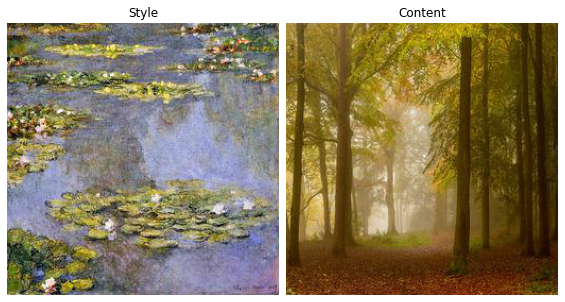

In [92]:
#Create normalized datasets
dataset_monet = ImageDataset(path_monet, img_size=256, normalize=True)
dataset_photo = ImageDataset(path_photo, img_size=256, normalize=True)

#Create test loaders
batch_size_style = 1
batch_size_content = 1
style_loader_Y = DataLoader(dataset_monet, batch_size=batch_size_style, shuffle=False, num_workers=0, pin_memory=True)
content_loader_X = DataLoader(dataset_photo, batch_size=batch_size_content, shuffle=False, num_workers=0, pin_memory=True)

#Dataiter
dataiter_style = iter(style_loader_Y)
dataiter_content = iter(content_loader_X)

#Next image
style_img = dataiter_style.next()
content_img = dataiter_content.next()
style_img_show = im_convert(style_img)
content_img_show = im_convert(content_img)

#transformation next to each other
fig, (ax1, ax2) = plt.subplots(1, 2, sharex=True, sharey=True, figsize=(10, 5))
ax1.imshow(style_img_show)
ax1.axis('off')
ax1.set_title('Style')
ax2.imshow(content_img_show)
ax2.axis('off')
ax2.set_title('Content')
fig.subplots_adjust(wspace=0, hspace=0)
plt.show()

### Specific image

In [93]:
style_img = load_image(path_monet+"79292e1434.jpg").to(device) #"853f8d711f.jpg" or "79292e1434.jpg" or "a619072f82.jpg"
content_img = load_image(path_photo+"11bcbf0f67.jpg").to(device)

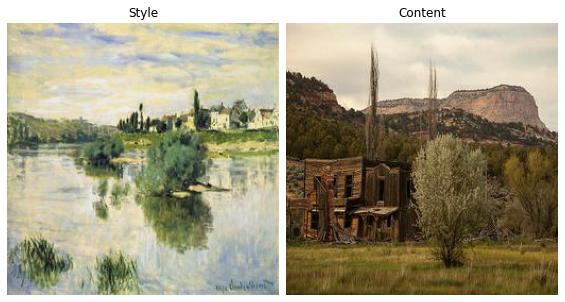

In [94]:
#transformation next to each other
fig, (ax1, ax2) = plt.subplots(1, 2, sharex=True, sharey=True, figsize=(10, 5))
ax1.imshow(im_convert(style_img))
ax1.axis('off')
ax1.set_title('Style')
ax2.imshow(im_convert(content_img))
ax2.axis('off')
ax2.set_title('Content')
fig.subplots_adjust(wspace=0, hspace=0)
plt.show()

## General style transfer functions

### Pre-trained VGG19

In [95]:
#get the "features" portion of VGG19 (we will not need the "classifier" portion)
loss_model = models.vgg19(pretrained=True).features

#freeze all parameters since we are only optimizing the target image / autoencoder
for param in loss_model.parameters():
    param.requires_grad_(False)

In [96]:
#Move model to correct device (based on availability)
loss_model.to(device)

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

### Feature extraction

In [97]:
def get_features(image, model, layers=None):
    """Run an image forward through a model and get the features for a set of layers"""
    
    # Need the layers for the content and style representations of an image
    if layers is None:
        layers = {'0': 'conv1_1', #style
                  '5': 'conv2_1', #style
                  '10': 'conv3_1', #style
                  '19': 'conv4_1', #style
                  '21': 'conv4_2', #content
                  '28': 'conv5_1'} #style
    
    features = {}
    x = image
    for name, layer in model._modules.items(): # model._modules is a dictionary holding each module in the model
        x = layer(x)
        if name in layers:
            features[layers[name]] = x
            
    return features

### Calculation of gram matrix - required for style

In [98]:
def gram_matrix(tensor):
    """Calculate the Gram Matrix of a given tensor. More information can be found under https://en.wikipedia.org/wiki/Gramian_matrix"""
    
    #get the batch_size, depth, height, and width of the Tensor
    _, d, h, w = tensor.size()
    
    #reshape so we're multiplying the features for each channel
    tensor = tensor.view(d, h * w)
    
    #calculate the gram matrix
    gram = torch.mm(tensor, tensor.t())
    
    return gram

## Loss functions

In [99]:
def layer_loss(target_layer, content_layer, layer_weight, method="mse"):
    """Calculates difference between two layers / gram matrices"""
    
    if method == "mse":
        loss_ = torch.mean((target_layer - content_layer)**2)
    
    if method == "mae":
        loss_ = torch.mean(torch.abs(target_layer - content_layer))
        
    return loss_ * layer_weight

In [100]:
def total_loss(target, content_features, style_features, style_grams, loss_model, style_weights, content_weights, alpha_weight, beta_weight, method="mse"):
    """Calculates style and content loss for target image (in comparison with style and content image)"""
    
    #get the features from your target image
    target_features = get_features(target, loss_model)
    
    # =========================================
    # Content loss 
    # =========================================
    
    #initialize the content loss to 0
    content_loss = 0.0
    
    #Loop through each layer
    for layer in content_weights:
        
#         #get the content representation of the target
#         target_feature = target_features[layer]
#         batch_size_, d, h, w = target_feature.shape
        
        #the content loss for one layer, weighted appropriately
        layer_content_loss = layer_loss(target_features[layer], content_features[layer], content_weights[layer], method)
        
        #add to content loss
        content_loss += layer_content_loss #/ (d * h * w)
    
    # =========================================
    # Style loss 
    # =========================================
    
    #initialize the style loss to 0
    style_loss = 0.0
    
    # then add to it for each layer's gram matrix loss
    for layer in style_weights:
        
        #get the "target" style representation for the layer
        target_feature = target_features[layer]
        target_gram = gram_matrix(target_feature)
        batch_size_, d, h, w = target_feature.shape
        
        #get the "style" representation
        style_gram = style_grams[layer]
        
        #the style loss for one layer, weighted appropriately
        layer_style_loss = layer_loss(target_gram, style_gram, style_weights[layer], method)
        
        #add to style loss
        style_loss += layer_style_loss / (d * h * w)
    
    # =========================================
    # Perceptual loss 
    # =========================================
    
    #calculate the total loss
    total_loss = alpha_weight * content_loss + beta_weight * style_loss
    
    return total_loss, alpha_weight * content_loss, beta_weight * style_loss

## Autoencoder

In [101]:
def conv(in_channels, out_channels, kernel_size, stride=2, padding=1, instance_norm=True):
    """Creates a convolutional layer, with optional instance normalization"""
    
    #Add layers
    layers = []
    conv_layer = nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride, padding=padding, bias=False)
    layers.append(conv_layer)
    
    #Instance normalization
    if instance_norm:
        layers.append(nn.InstanceNorm2d(out_channels))
        
    return nn.Sequential(*layers)

In [102]:
class ResidualBlock(nn.Module):

    def __init__(self, conv_dim):
        super(ResidualBlock, self).__init__()
        """Residual blocks help the model to effectively learn the transformation from one domain to another"""
        self.conv1 = conv(in_channels=conv_dim, out_channels=conv_dim, kernel_size=3, stride=1, padding=1, instance_norm=True)
        self.conv2 = conv(in_channels=conv_dim, out_channels=conv_dim, kernel_size=3, stride=1, padding=1, instance_norm=True)
        
    def forward(self, x):
        out_1 = F.relu(self.conv1(x))
        out_2 = x + self.conv2(out_1)
        return out_2

In [103]:
def deconv(in_channels, out_channels, kernel_size, stride=2, padding=1, output_padding=0, instance_norm=True, dropout=False, dropout_ratio=0.5):
    """Creates a transpose convolutional layer, with optional batch / instance normalization. Select either batch OR instance normalization."""
    
    #Add layers
    layers = []
    layers.append(nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, output_padding, bias=False))
    
    #Instance normalization
    if instance_norm:
        layers.append(nn.InstanceNorm2d(out_channels))
    
    #Dropout
    if dropout:
        layers.append(nn.Dropout2d(dropout_ratio))
    
    return nn.Sequential(*layers)

In [104]:
class Generator(nn.Module):
    
    def __init__(self, conv_dim=32, n_res_blocks=5):
        super(Generator, self).__init__()
        """Input is RGB image (256x256x3) while output is a single value"""
        
        #Encoder layers
        self.conv1 = conv(in_channels=3, out_channels=conv_dim, kernel_size=9, stride=1, padding=4, instance_norm=True) # (256, 256, 32)
        self.conv2 = conv(in_channels=conv_dim, out_channels=conv_dim*2, kernel_size=3, stride=2, padding=1, instance_norm=True) # (128, 128, 64)
        self.conv3 = conv(in_channels=conv_dim*2, out_channels=conv_dim*4, kernel_size=3, stride=2, padding=1, instance_norm=True) # (64, 64, 128)
        
        #Residual blocks (number depends on input parameter)
        res_layers = []
        for layer in range(n_res_blocks):
            res_layers.append(ResidualBlock(conv_dim*4)) #(64, 64, 128)
        self.res_blocks = nn.Sequential(*res_layers)
        
        #Decoder layers
        self.deconv1 = deconv(in_channels=conv_dim*4, out_channels=conv_dim*2, kernel_size=3, stride=2, padding=1, output_padding=1, instance_norm=True) # (128, 128, 64)
        self.deconv2 = deconv(in_channels=conv_dim*2, out_channels=conv_dim, kernel_size=3, stride=2, padding=1, output_padding=1, instance_norm=True) # (256, 256, 32)
        self.deconv3 = deconv(in_channels=conv_dim, out_channels=3, kernel_size=9, stride=1, padding=4, instance_norm=True) # (256, 256, 3)
        
    def forward(self, x):
        """Given an image x, returns a transformed image."""
        
        #Encoder
        out = F.leaky_relu(self.conv1(x), negative_slope=0.1) # (256, 256, 32)
        out = F.leaky_relu(self.conv2(out), negative_slope=0.1) # (128, 128, 64)
        out = F.leaky_relu(self.conv3(out), negative_slope=0.1) # (64, 64, 128)
        
        #Residual blocks
        out = self.res_blocks(out) #(64, 64, 128)
        
        #Decoder
        out = F.leaky_relu(self.deconv1(out), negative_slope=0.1) # (128, 128, 64)
        out = F.leaky_relu(self.deconv2(out), negative_slope=0.1) # (256, 256, 32)
        out = torch.tanh(self.deconv3(out)) # (256, 256, 3)
        
        return out

In [105]:
def weights_init_normal(m):
    """
    Applies initial weights to certain layers in a model.
    The weights are taken from a normal distribution with mean = 0, std dev = 0.02.
    Param m: A module or layer in a network    
    """
    #classname will be something like: `Conv`, `BatchNorm2d`, `Linear`, etc.
    classname = m.__class__.__name__
    
    #normal distribution with given paramters
    std_dev = 0.02
    mean = 0.0
    
    # Initialize conv layer
    if hasattr(m, 'weight') and (classname.find('Conv') != -1):
        init.normal_(m.weight.data, mean, std_dev)

In [135]:
def build_model(g_conv_dim=32, n_res_blocks=5):
    """
    Builds models and moves them to correct device
    """
    
    #Generator
    G_XtoY = Generator(conv_dim=g_conv_dim, n_res_blocks=n_res_blocks)
    
    #Weight initialization
    G_XtoY.apply(weights_init_normal)
    
    #Moves models to GPU, if available
    if torch.cuda.is_available():
        G_XtoY.to(device)
        print('Model moved to GPU.')
    else:
        print('Only CPU available.')

    return G_XtoY

In [144]:
#Build models
G_XtoY = build_model()

Model moved to GPU.


In [145]:
#Check model structure
print(G_XtoY)

Generator(
  (conv1): Sequential(
    (0): Conv2d(3, 32, kernel_size=(9, 9), stride=(1, 1), padding=(4, 4), bias=False)
    (1): InstanceNorm2d(32, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
  )
  (conv2): Sequential(
    (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
  )
  (conv3): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
  )
  (res_blocks): Sequential(
    (0): ResidualBlock(
      (conv1): Sequential(
        (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
      )
      (conv2): Sequential(
        (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(

## Optimizer & layer weighting

In [146]:
#hyperparameter
lr=0.002 ##0.0002
beta1=0.900 #exponential decay rate for the first moment estimates
beta2=0.999 #exponential decay rate for the second-moment estimates

#Optimizers for autoencoder
g_optimizer = optim.Adam(G_XtoY.parameters(), lr, [beta1, beta2])

#scheduling learning rate reduction
scheduler = MultiStepLR(g_optimizer, milestones=[10000], gamma=0.5)

Below, you can weight the style representation at each layer. Weighting the earlier layers (conv1_1 and conv2_1) higher should result in larger style artifacts in the resulting target image. Weighting the later layers should emphasise smaller features.

In [147]:
#Weighting scheme for each layer
style_weights = {'conv1_1': 0.90, #0.90
                 'conv2_1': 0.75, #0.75
                 'conv3_1': 0.50, #0.50
                 'conv4_1': 0.25, #0.25
                 'conv5_1': 0.10} #0.10
content_weights = {'conv4_2': 0.99}

#Content vs. style
alpha_weight = 1.0e2  # content_weight
beta_weight = 1.0e1  # style_weight

The ratio of the alpha and beta weight determines the relative importance of style vs content. A high ratio results in small changes from the content and little style transfer. The lower the ratio the more style is "imported" so to speak.

In [148]:
print("Ratio of content / style weight is: {:6.6f}".format(alpha_weight / beta_weight))

Ratio of content / style weight is: 10.000000


## Training

In [143]:
def training_loop(style_img, content_img=None, n_epochs=100):
    """Trains residual autoencoder to transform any image to required style"""
    
    #Start training time
    start = time.time()
    
    #Admin parameters
    print_every = 100
    show_every = 1000
    checkpoint_every = 1000
    
    #If no specific content image was provided assume that we use train the first 4 images of the photo set
    if content_img == None:
        batch_size_content = 1
        content_loader_X = DataLoader(dataset_photo, batch_size=batch_size_content, shuffle=False, num_workers=0, pin_memory=True)
        dataiter_content = iter(content_loader_X)
        batches_per_epoch = min(4, len(dataiter_content))#i only want a maximum of 100 batches per epoch
    else:
        batch_size_content = 1
        batches_per_epoch = 1
        content_img_ = content_img.to(device)
        
    #Moves images to GPU, if available
    style_img = style_img.to(device)
    
    #epoch losses over time
    losses = []
    
    #get content and style features only once before forming the target image
    style_features = get_features(style_img, loss_model)
    style_grams = {layer: gram_matrix(style_features[layer]) for layer in style_features}
    
    #run training loop
    for epoch in range(1, n_epochs+1):
        
        total_perceptual_loss = 0.0
        content_loss = 0.0
        style_loss = 0.0
        
        #reset iterators for each epoch
        if (epoch % (batches_per_epoch+1) == 0) & (content_img == None):
            dataiter_content = iter(content_loader_X)
        
        #loop through batches per epoch
        for batch in range(1, batches_per_epoch+1):
            
            if content_img == None:
                content_img_ = dataiter_content.next()
                content_img_ = content_img_.to(device)
            
            #Extract features
            content_features = get_features(content_img_, loss_model)
            
            #Back to the start
            g_optimizer.zero_grad()
        
            #transformation
            fake_Y = G_XtoY(content_img_)
            fake_Y.to(device)
            
            #batch perceptual_loss
            batch_perceptual_loss, batch_content_loss, batch_style_loss = total_loss(fake_Y, content_features, style_features, style_grams, loss_model, style_weights, content_weights, alpha_weight, beta_weight)
        
            #Optimization step
            batch_perceptual_loss.backward()
            g_optimizer.step()
            
            #perceptual_loss
            total_perceptual_loss += batch_perceptual_loss / batches_per_epoch
            content_loss += batch_content_loss / batches_per_epoch
            style_loss += batch_style_loss / batches_per_epoch
        
        # =========================================
        # Admin 
        # =========================================
        
        #Get time since started
        end = time.time()
        elapsed = end - start #in seconds
        elapsed = elapsed/60.0
        
        #print log info
        if epoch % print_every == 0:
            # append real and fake discriminator losses and the generator loss
            losses.append((content_loss.item(), style_loss.item(), total_perceptual_loss.item()))
            print('Epoch [{:5d}/{:5d}] | minutes since start: {:6.2f} | content_loss: {:6.4f} | style_loss: {:6.4f} | total_perceptual_loss: {:6.4f}'.format(
                    epoch, n_epochs, elapsed, content_loss.item(), style_loss.item(), total_perceptual_loss.item()))
        
        #show the generated samples
        if epoch % show_every == 0:
            #set generator to eval mode for image generation
            G_XtoY.eval()
            show_test(style_img, content_img_, G_XtoY)
            #set generator to train mode to continue training
            G_XtoY.train()
        
        #Adjust learning rate if requirements meet
        scheduler.step()
        
#         #save the model parameters
#         if epoch % checkpoint_every == 0:
#             save_checkpoint(epoch, G_XtoY)
    
    return losses

## Sample application (one-to-one)

As mentioned in the introduction this approach would typically be used for one-to-many translation. However, we will use it for one-to-one here which means we are not leveraging its full potential for generalization. Please keep that in mind as you view the results. The model is build so that the generalization should be possible.

Epoch [  100/12000] | minutes since start:   0.14 | content_loss: 311.9771 | style_loss: 110.4298 | total_perceptual_loss: 422.4068
Epoch [  200/12000] | minutes since start:   0.28 | content_loss: 285.6877 | style_loss: 100.1022 | total_perceptual_loss: 385.7900
Epoch [  300/12000] | minutes since start:   0.41 | content_loss: 250.1774 | style_loss: 89.4314 | total_perceptual_loss: 339.6089
Epoch [  400/12000] | minutes since start:   0.55 | content_loss: 188.0048 | style_loss: 40.7662 | total_perceptual_loss: 228.7709
Epoch [  500/12000] | minutes since start:   0.69 | content_loss: 69.4962 | style_loss: 14.7964 | total_perceptual_loss: 84.2926
Epoch [  600/12000] | minutes since start:   0.83 | content_loss: 60.7917 | style_loss: 12.6407 | total_perceptual_loss: 73.4324
Epoch [  700/12000] | minutes since start:   0.97 | content_loss: 27.5433 | style_loss: 10.2526 | total_perceptual_loss: 37.7959
Epoch [  800/12000] | minutes since start:   1.11 | content_loss: 320.6562 | style_loss

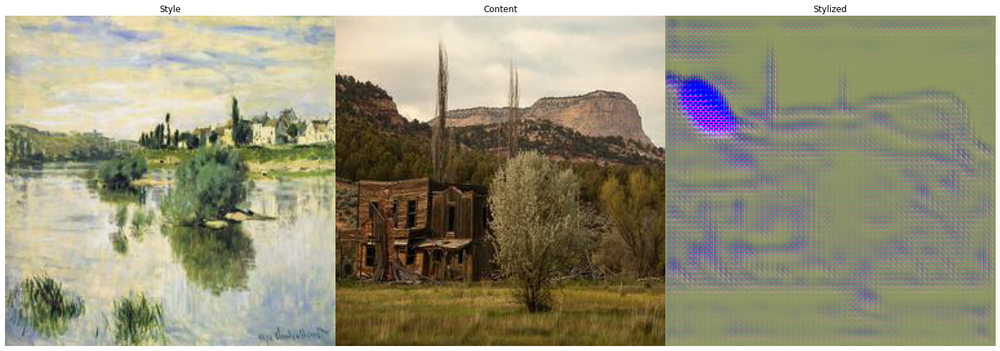

Epoch [ 1100/12000] | minutes since start:   1.54 | content_loss: 153.1209 | style_loss: 32.6352 | total_perceptual_loss: 185.7561
Epoch [ 1200/12000] | minutes since start:   1.67 | content_loss: 82.6956 | style_loss: 18.0033 | total_perceptual_loss: 100.6989
Epoch [ 1300/12000] | minutes since start:   1.81 | content_loss: 55.0198 | style_loss: 13.9911 | total_perceptual_loss: 69.0109
Epoch [ 1400/12000] | minutes since start:   1.95 | content_loss: 36.5020 | style_loss: 11.6581 | total_perceptual_loss: 48.1601
Epoch [ 1500/12000] | minutes since start:   2.09 | content_loss: 24.5103 | style_loss: 10.2973 | total_perceptual_loss: 34.8076
Epoch [ 1600/12000] | minutes since start:   2.23 | content_loss: 19.8637 | style_loss: 9.4655 | total_perceptual_loss: 29.3292
Epoch [ 1700/12000] | minutes since start:   2.37 | content_loss: 242.0562 | style_loss: 46.1544 | total_perceptual_loss: 288.2107
Epoch [ 1800/12000] | minutes since start:   2.50 | content_loss: 94.0011 | style_loss: 16.03

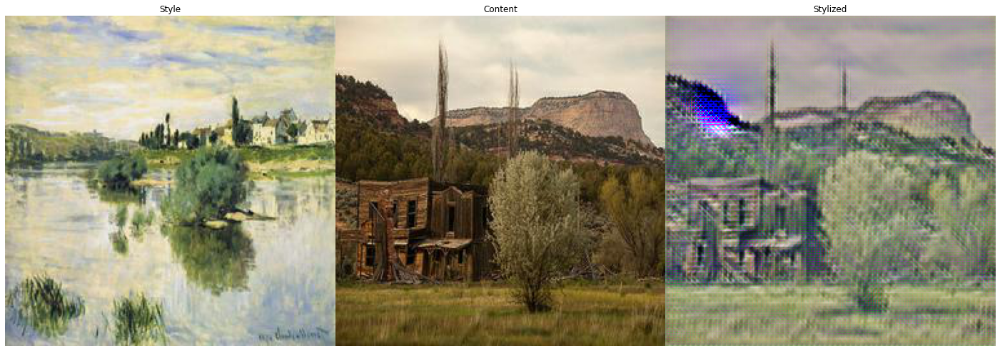

Epoch [ 2100/12000] | minutes since start:   2.93 | content_loss: 20.1202 | style_loss: 9.7098 | total_perceptual_loss: 29.8301
Epoch [ 2200/12000] | minutes since start:   3.07 | content_loss: 16.9480 | style_loss: 8.8159 | total_perceptual_loss: 25.7639
Epoch [ 2300/12000] | minutes since start:   3.21 | content_loss: 13.0173 | style_loss: 8.2520 | total_perceptual_loss: 21.2693
Epoch [ 2400/12000] | minutes since start:   3.35 | content_loss: 11.5539 | style_loss: 7.7256 | total_perceptual_loss: 19.2795
Epoch [ 2500/12000] | minutes since start:   3.49 | content_loss: 9.4943 | style_loss: 7.3867 | total_perceptual_loss: 16.8810
Epoch [ 2600/12000] | minutes since start:   3.63 | content_loss: 8.5474 | style_loss: 7.0140 | total_perceptual_loss: 15.5614
Epoch [ 2700/12000] | minutes since start:   3.76 | content_loss: 8.1028 | style_loss: 6.7496 | total_perceptual_loss: 14.8524
Epoch [ 2800/12000] | minutes since start:   3.90 | content_loss: 87.0452 | style_loss: 13.7460 | total_per

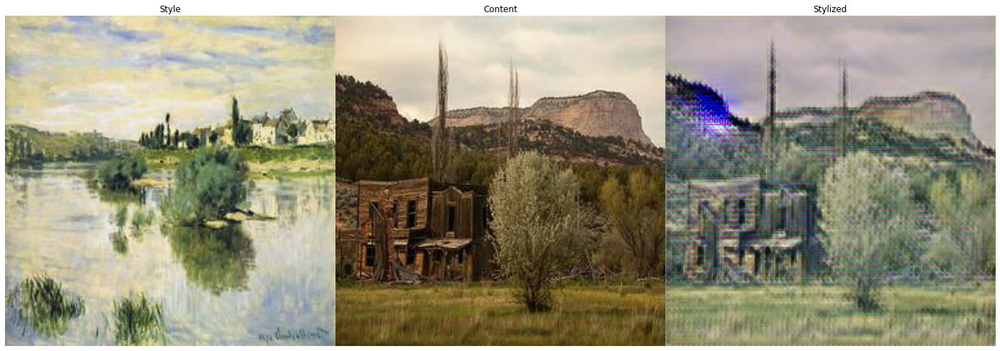

Epoch [ 3100/12000] | minutes since start:   4.33 | content_loss: 16.5325 | style_loss: 8.2231 | total_perceptual_loss: 24.7556
Epoch [ 3200/12000] | minutes since start:   4.47 | content_loss: 17.0239 | style_loss: 8.3821 | total_perceptual_loss: 25.4060
Epoch [ 3300/12000] | minutes since start:   4.61 | content_loss: 11.7659 | style_loss: 7.5711 | total_perceptual_loss: 19.3370
Epoch [ 3400/12000] | minutes since start:   4.75 | content_loss: 9.8503 | style_loss: 7.2386 | total_perceptual_loss: 17.0890
Epoch [ 3500/12000] | minutes since start:   4.88 | content_loss: 8.2625 | style_loss: 6.7867 | total_perceptual_loss: 15.0492
Epoch [ 3600/12000] | minutes since start:   5.02 | content_loss: 7.6775 | style_loss: 6.6084 | total_perceptual_loss: 14.2859
Epoch [ 3700/12000] | minutes since start:   5.16 | content_loss: 6.8421 | style_loss: 6.1886 | total_perceptual_loss: 13.0307
Epoch [ 3800/12000] | minutes since start:   5.30 | content_loss: 7.1169 | style_loss: 6.2097 | total_percep

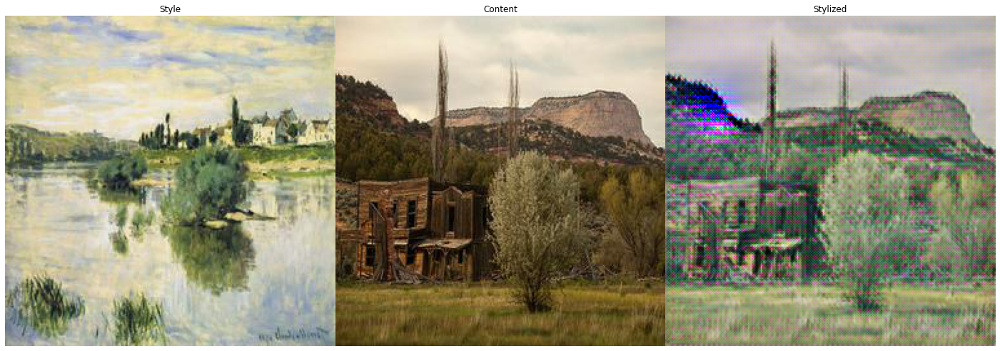

Epoch [ 4100/12000] | minutes since start:   5.73 | content_loss: 4.9849 | style_loss: 5.3237 | total_perceptual_loss: 10.3085
Epoch [ 4200/12000] | minutes since start:   5.86 | content_loss: 181.3033 | style_loss: 24.1141 | total_perceptual_loss: 205.4174
Epoch [ 4300/12000] | minutes since start:   6.00 | content_loss: 79.0385 | style_loss: 14.1958 | total_perceptual_loss: 93.2344
Epoch [ 4400/12000] | minutes since start:   6.14 | content_loss: 43.0034 | style_loss: 11.0565 | total_perceptual_loss: 54.0599
Epoch [ 4500/12000] | minutes since start:   6.28 | content_loss: 26.3720 | style_loss: 9.5849 | total_perceptual_loss: 35.9569
Epoch [ 4600/12000] | minutes since start:   6.42 | content_loss: 19.2698 | style_loss: 8.4222 | total_perceptual_loss: 27.6920
Epoch [ 4700/12000] | minutes since start:   6.56 | content_loss: 14.5664 | style_loss: 7.9839 | total_perceptual_loss: 22.5503
Epoch [ 4800/12000] | minutes since start:   6.70 | content_loss: 18.6734 | style_loss: 8.1799 | tot

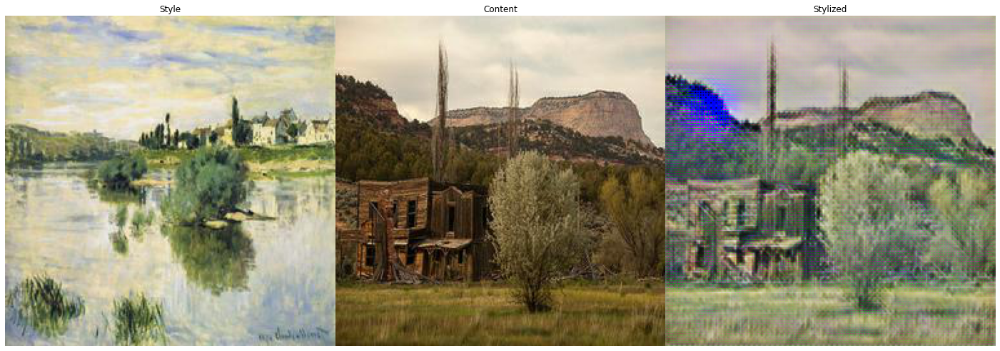

Epoch [ 5100/12000] | minutes since start:   7.12 | content_loss: 28.6731 | style_loss: 9.0751 | total_perceptual_loss: 37.7482
Epoch [ 5200/12000] | minutes since start:   7.26 | content_loss: 10.9272 | style_loss: 7.0323 | total_perceptual_loss: 17.9594
Epoch [ 5300/12000] | minutes since start:   7.40 | content_loss: 8.8915 | style_loss: 6.4414 | total_perceptual_loss: 15.3329
Epoch [ 5400/12000] | minutes since start:   7.54 | content_loss: 7.1822 | style_loss: 6.1156 | total_perceptual_loss: 13.2978
Epoch [ 5500/12000] | minutes since start:   7.68 | content_loss: 6.7185 | style_loss: 5.9095 | total_perceptual_loss: 12.6280
Epoch [ 5600/12000] | minutes since start:   7.82 | content_loss: 77.5903 | style_loss: 13.5526 | total_perceptual_loss: 91.1429
Epoch [ 5700/12000] | minutes since start:   7.95 | content_loss: 22.7606 | style_loss: 8.8974 | total_perceptual_loss: 31.6580
Epoch [ 5800/12000] | minutes since start:   8.09 | content_loss: 13.7991 | style_loss: 7.5898 | total_per

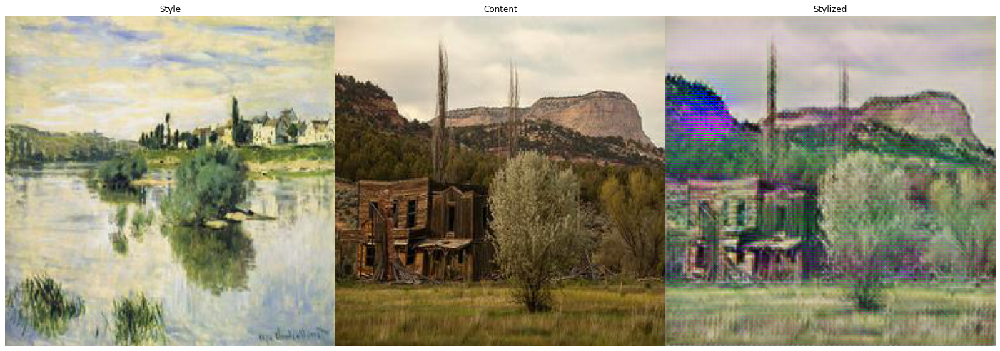

Epoch [ 6100/12000] | minutes since start:   8.52 | content_loss: 6.8788 | style_loss: 6.0094 | total_perceptual_loss: 12.8882
Epoch [ 6200/12000] | minutes since start:   8.66 | content_loss: 7.8085 | style_loss: 5.6711 | total_perceptual_loss: 13.4796
Epoch [ 6300/12000] | minutes since start:   8.80 | content_loss: 5.6610 | style_loss: 5.6691 | total_perceptual_loss: 11.3301
Epoch [ 6400/12000] | minutes since start:   8.94 | content_loss: 5.5254 | style_loss: 5.2829 | total_perceptual_loss: 10.8083
Epoch [ 6500/12000] | minutes since start:   9.07 | content_loss: 4.6548 | style_loss: 5.0819 | total_perceptual_loss: 9.7367
Epoch [ 6600/12000] | minutes since start:   9.21 | content_loss: 49.4144 | style_loss: 12.3623 | total_perceptual_loss: 61.7767
Epoch [ 6700/12000] | minutes since start:   9.35 | content_loss: 40.0423 | style_loss: 10.2313 | total_perceptual_loss: 50.2736
Epoch [ 6800/12000] | minutes since start:   9.49 | content_loss: 18.7395 | style_loss: 7.9469 | total_perce

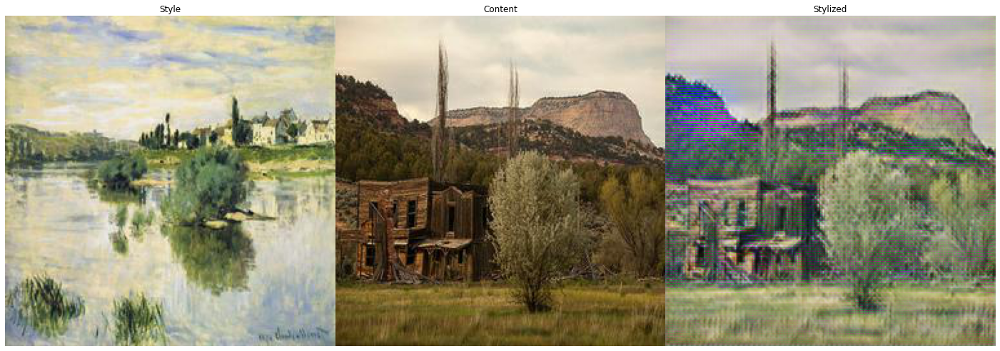

Epoch [ 7100/12000] | minutes since start:   9.92 | content_loss: 7.4802 | style_loss: 5.9587 | total_perceptual_loss: 13.4388
Epoch [ 7200/12000] | minutes since start:  10.06 | content_loss: 7.4045 | style_loss: 6.0498 | total_perceptual_loss: 13.4543
Epoch [ 7300/12000] | minutes since start:  10.19 | content_loss: 5.4040 | style_loss: 5.4312 | total_perceptual_loss: 10.8351
Epoch [ 7400/12000] | minutes since start:  10.33 | content_loss: 4.7061 | style_loss: 5.1742 | total_perceptual_loss: 9.8803
Epoch [ 7500/12000] | minutes since start:  10.47 | content_loss: 4.2476 | style_loss: 4.9431 | total_perceptual_loss: 9.1906
Epoch [ 7600/12000] | minutes since start:  10.61 | content_loss: 4.6229 | style_loss: 4.8465 | total_perceptual_loss: 9.4694
Epoch [ 7700/12000] | minutes since start:  10.75 | content_loss: 3.9115 | style_loss: 4.6899 | total_perceptual_loss: 8.6014
Epoch [ 7800/12000] | minutes since start:  10.89 | content_loss: 15.9563 | style_loss: 7.3164 | total_perceptual_l

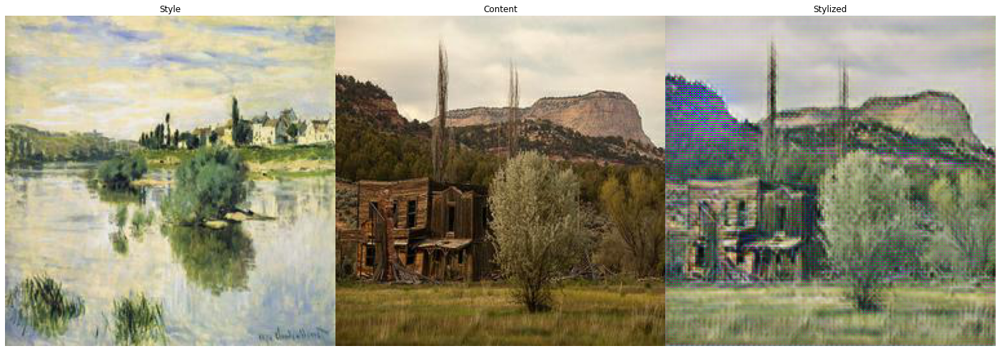

Epoch [ 8100/12000] | minutes since start:  11.32 | content_loss: 4.5440 | style_loss: 5.0244 | total_perceptual_loss: 9.5685
Epoch [ 8200/12000] | minutes since start:  11.46 | content_loss: 3.6649 | style_loss: 4.7998 | total_perceptual_loss: 8.4647
Epoch [ 8300/12000] | minutes since start:  11.60 | content_loss: 4.2890 | style_loss: 5.0017 | total_perceptual_loss: 9.2907
Epoch [ 8400/12000] | minutes since start:  11.73 | content_loss: 3.3175 | style_loss: 4.6168 | total_perceptual_loss: 7.9344
Epoch [ 8500/12000] | minutes since start:  11.87 | content_loss: 3.0204 | style_loss: 4.4309 | total_perceptual_loss: 7.4514
Epoch [ 8600/12000] | minutes since start:  12.01 | content_loss: 2.8106 | style_loss: 4.3074 | total_perceptual_loss: 7.1181
Epoch [ 8700/12000] | minutes since start:  12.15 | content_loss: 2.8880 | style_loss: 4.2185 | total_perceptual_loss: 7.1065
Epoch [ 8800/12000] | minutes since start:  12.29 | content_loss: 2.8866 | style_loss: 4.1701 | total_perceptual_loss:

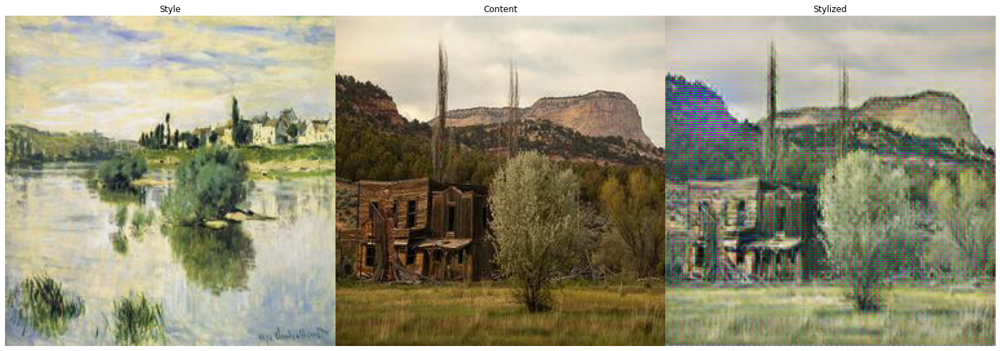

Epoch [ 9100/12000] | minutes since start:  12.72 | content_loss: 33.1403 | style_loss: 9.2650 | total_perceptual_loss: 42.4053
Epoch [ 9200/12000] | minutes since start:  12.85 | content_loss: 13.6082 | style_loss: 7.1452 | total_perceptual_loss: 20.7534
Epoch [ 9300/12000] | minutes since start:  12.99 | content_loss: 10.3914 | style_loss: 6.8742 | total_perceptual_loss: 17.2655
Epoch [ 9400/12000] | minutes since start:  13.13 | content_loss: 6.9804 | style_loss: 5.9183 | total_perceptual_loss: 12.8987
Epoch [ 9500/12000] | minutes since start:  13.27 | content_loss: 5.3428 | style_loss: 5.4934 | total_perceptual_loss: 10.8362
Epoch [ 9600/12000] | minutes since start:  13.41 | content_loss: 4.8557 | style_loss: 5.1615 | total_perceptual_loss: 10.0173
Epoch [ 9700/12000] | minutes since start:  13.55 | content_loss: 24.0142 | style_loss: 8.5475 | total_perceptual_loss: 32.5617
Epoch [ 9800/12000] | minutes since start:  13.69 | content_loss: 11.2932 | style_loss: 6.8542 | total_perc

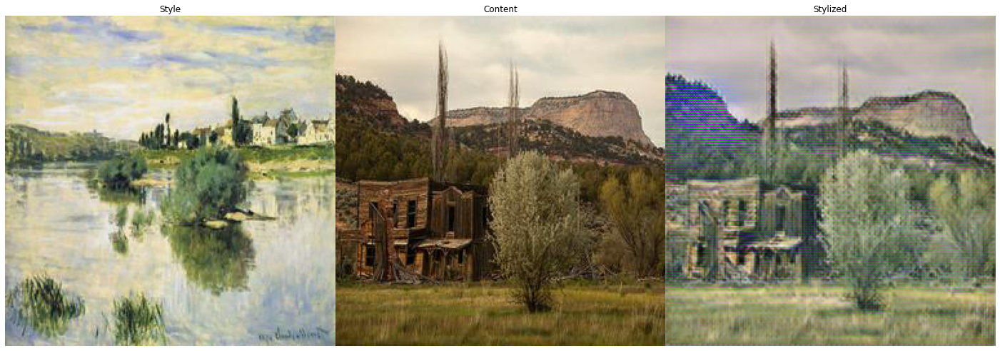

Epoch [10100/12000] | minutes since start:  14.11 | content_loss: 5.0222 | style_loss: 5.4308 | total_perceptual_loss: 10.4530
Epoch [10200/12000] | minutes since start:  14.25 | content_loss: 4.5458 | style_loss: 5.2652 | total_perceptual_loss: 9.8111
Epoch [10300/12000] | minutes since start:  14.39 | content_loss: 4.1764 | style_loss: 5.1274 | total_perceptual_loss: 9.3037
Epoch [10400/12000] | minutes since start:  14.53 | content_loss: 3.9563 | style_loss: 4.9921 | total_perceptual_loss: 8.9483
Epoch [10500/12000] | minutes since start:  14.67 | content_loss: 3.7739 | style_loss: 4.8946 | total_perceptual_loss: 8.6685
Epoch [10600/12000] | minutes since start:  14.81 | content_loss: 3.4586 | style_loss: 4.7682 | total_perceptual_loss: 8.2268
Epoch [10700/12000] | minutes since start:  14.95 | content_loss: 3.4057 | style_loss: 4.7186 | total_perceptual_loss: 8.1243
Epoch [10800/12000] | minutes since start:  15.08 | content_loss: 3.4433 | style_loss: 4.6122 | total_perceptual_loss

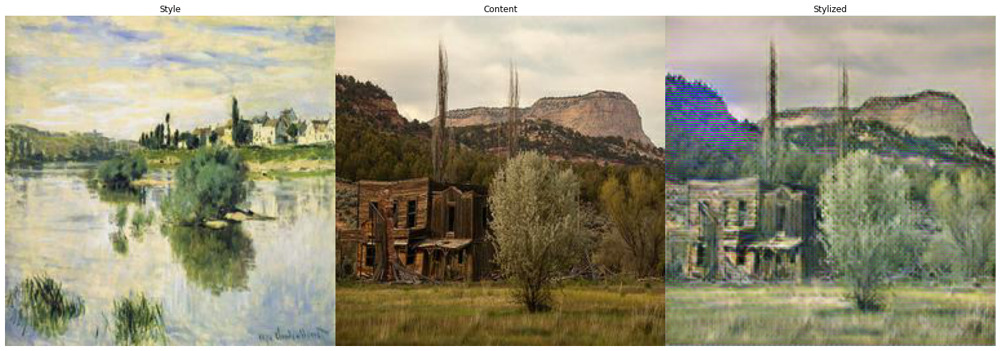

Epoch [11100/12000] | minutes since start:  15.51 | content_loss: 2.8782 | style_loss: 4.3879 | total_perceptual_loss: 7.2662
Epoch [11200/12000] | minutes since start:  15.65 | content_loss: 3.1307 | style_loss: 4.3090 | total_perceptual_loss: 7.4397
Epoch [11300/12000] | minutes since start:  15.79 | content_loss: 25.8367 | style_loss: 5.7549 | total_perceptual_loss: 31.5915
Epoch [11400/12000] | minutes since start:  15.93 | content_loss: 2.9753 | style_loss: 4.5086 | total_perceptual_loss: 7.4839
Epoch [11500/12000] | minutes since start:  16.07 | content_loss: 2.7023 | style_loss: 4.3092 | total_perceptual_loss: 7.0115
Epoch [11600/12000] | minutes since start:  16.21 | content_loss: 2.5782 | style_loss: 4.2018 | total_perceptual_loss: 6.7800
Epoch [11700/12000] | minutes since start:  16.34 | content_loss: 2.4088 | style_loss: 4.1302 | total_perceptual_loss: 6.5390
Epoch [11800/12000] | minutes since start:  16.48 | content_loss: 2.3313 | style_loss: 4.0592 | total_perceptual_los

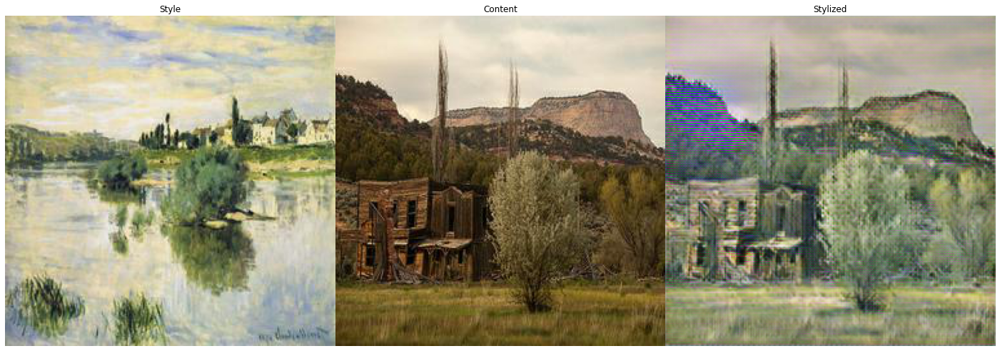

In [113]:
#go train!
losses = training_loop(style_img, content_img, n_epochs=12000)

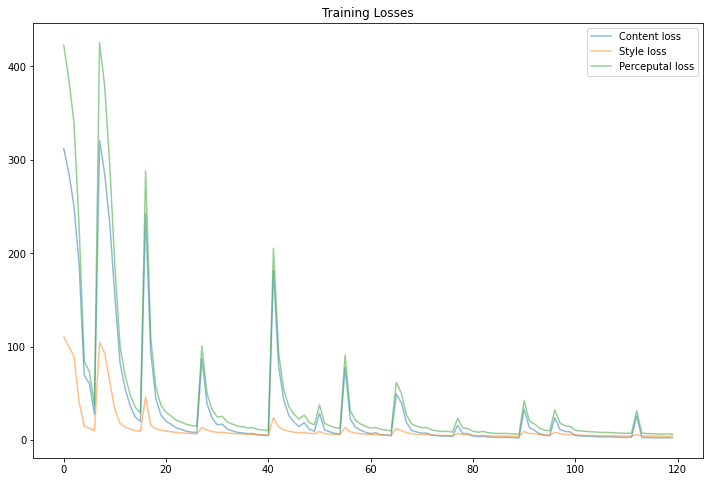

In [114]:
#Plot loss functions over training
fig, ax = plt.subplots(figsize=(12,8))
losses = np.array(losses)
plt.plot(losses.T[0], label='Content loss', alpha=0.5)
plt.plot(losses.T[1], label='Style loss', alpha=0.5)
plt.plot(losses.T[2], label='Perceputal loss', alpha=0.5)
plt.title("Training Losses")
plt.legend()
plt.show()

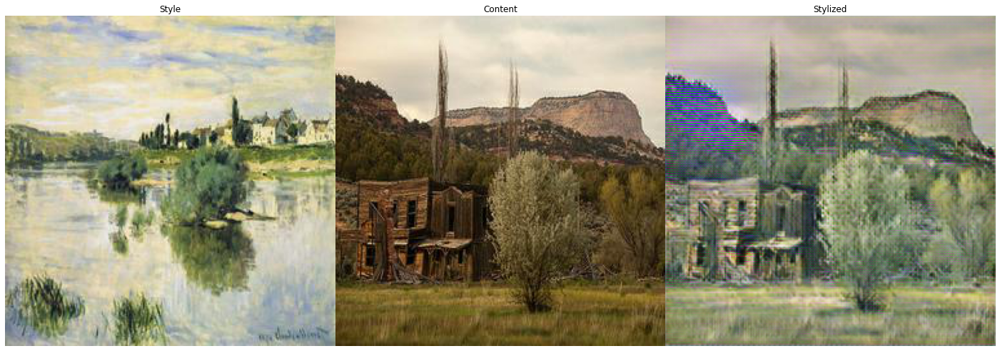

In [115]:
G_XtoY.eval()
show_test(style_img, content_img, G_XtoY)

## Sample application (one-to-many)

After rebuilding the model and optimuzer we re-run the training loop and train it one 4 images.

In [ ]:
#Build models
G_XtoY = build_model()

In [ ]:
#hyperparameter
lr=0.002 ##0.0002
beta1=0.900 #exponential decay rate for the first moment estimates
beta2=0.999 #exponential decay rate for the second-moment estimates

#Optimizers for autoencoder
g_optimizer = optim.Adam(G_XtoY.parameters(), lr, [beta1, beta2])

#scheduling learning rate reduction
scheduler = MultiStepLR(g_optimizer, milestones=[10000], gamma=0.5)

In [ ]:
#Weighting scheme for each layer
style_weights = {'conv1_1': 0.90, #0.90
                 'conv2_1': 0.75, #0.75
                 'conv3_1': 0.50, #0.50
                 'conv4_1': 0.25, #0.25
                 'conv5_1': 0.10} #0.10
content_weights = {'conv4_2': 0.99}

#Content vs. style
alpha_weight = 1.0e2  # content_weight
beta_weight = 1.0e1  # style_weight

Epoch [  100/ 4000] | minutes since start:   0.56 | content_loss: 414.7004 | style_loss: 94.3526 | total_perceptual_loss: 509.0530
Epoch [  200/ 4000] | minutes since start:   1.11 | content_loss: 407.5737 | style_loss: 83.1947 | total_perceptual_loss: 490.7684
Epoch [  300/ 4000] | minutes since start:   1.67 | content_loss: 384.5697 | style_loss: 59.9740 | total_perceptual_loss: 444.5437
Epoch [  400/ 4000] | minutes since start:   2.22 | content_loss: 324.2798 | style_loss: 30.1002 | total_perceptual_loss: 354.3800
Epoch [  500/ 4000] | minutes since start:   2.78 | content_loss: 260.7601 | style_loss: 22.3328 | total_perceptual_loss: 283.0929
Epoch [  600/ 4000] | minutes since start:   3.33 | content_loss: 218.6043 | style_loss: 21.6452 | total_perceptual_loss: 240.2495
Epoch [  700/ 4000] | minutes since start:   3.89 | content_loss: 167.0150 | style_loss: 19.8446 | total_perceptual_loss: 186.8597
Epoch [  800/ 4000] | minutes since start:   4.45 | content_loss: 140.5723 | style_

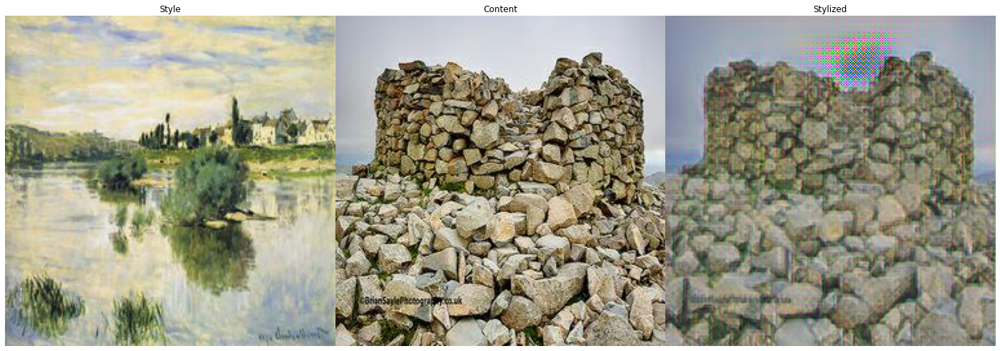

Epoch [ 1100/ 4000] | minutes since start:   6.12 | content_loss: 92.4269 | style_loss: 20.6167 | total_perceptual_loss: 113.0436
Epoch [ 1200/ 4000] | minutes since start:   6.68 | content_loss: 88.0465 | style_loss: 19.9733 | total_perceptual_loss: 108.0198
Epoch [ 1300/ 4000] | minutes since start:   7.24 | content_loss: 77.0605 | style_loss: 20.9316 | total_perceptual_loss: 97.9921
Epoch [ 1400/ 4000] | minutes since start:   7.79 | content_loss: 73.7607 | style_loss: 20.1921 | total_perceptual_loss: 93.9529
Epoch [ 1500/ 4000] | minutes since start:   8.35 | content_loss: 67.2782 | style_loss: 20.4728 | total_perceptual_loss: 87.7510
Epoch [ 1600/ 4000] | minutes since start:   8.90 | content_loss: 70.4073 | style_loss: 20.3365 | total_perceptual_loss: 90.7438
Epoch [ 1700/ 4000] | minutes since start:   9.46 | content_loss: 61.3180 | style_loss: 20.5923 | total_perceptual_loss: 81.9103
Epoch [ 1800/ 4000] | minutes since start:  10.01 | content_loss: 62.6659 | style_loss: 20.9958

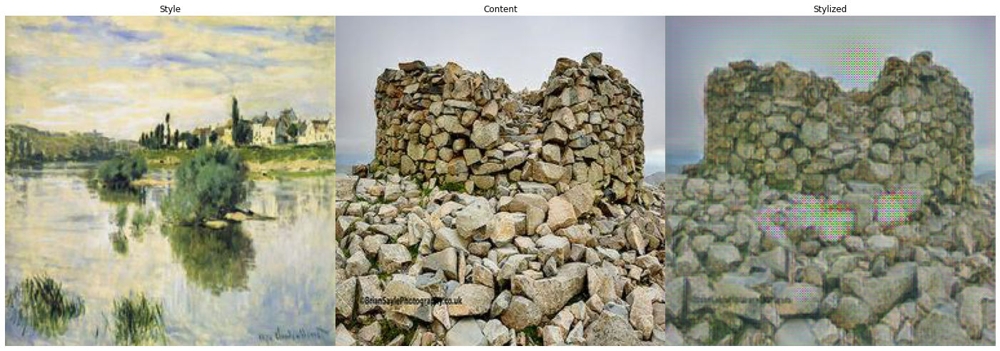

Epoch [ 2100/ 4000] | minutes since start:  11.70 | content_loss: 58.0797 | style_loss: 19.5838 | total_perceptual_loss: 77.6635
Epoch [ 2200/ 4000] | minutes since start:  12.25 | content_loss: 54.8458 | style_loss: 18.9293 | total_perceptual_loss: 73.7751
Epoch [ 2300/ 4000] | minutes since start:  12.81 | content_loss: 48.4202 | style_loss: 18.9503 | total_perceptual_loss: 67.3706
Epoch [ 2400/ 4000] | minutes since start:  13.36 | content_loss: 49.2940 | style_loss: 18.8713 | total_perceptual_loss: 68.1653
Epoch [ 2500/ 4000] | minutes since start:  13.92 | content_loss: 43.8025 | style_loss: 18.4344 | total_perceptual_loss: 62.2368
Epoch [ 2600/ 4000] | minutes since start:  14.48 | content_loss: 46.1932 | style_loss: 19.0814 | total_perceptual_loss: 65.2747
Epoch [ 2700/ 4000] | minutes since start:  15.03 | content_loss: 50.6429 | style_loss: 18.5882 | total_perceptual_loss: 69.2311
Epoch [ 2800/ 4000] | minutes since start:  15.59 | content_loss: 40.7364 | style_loss: 18.1874 |

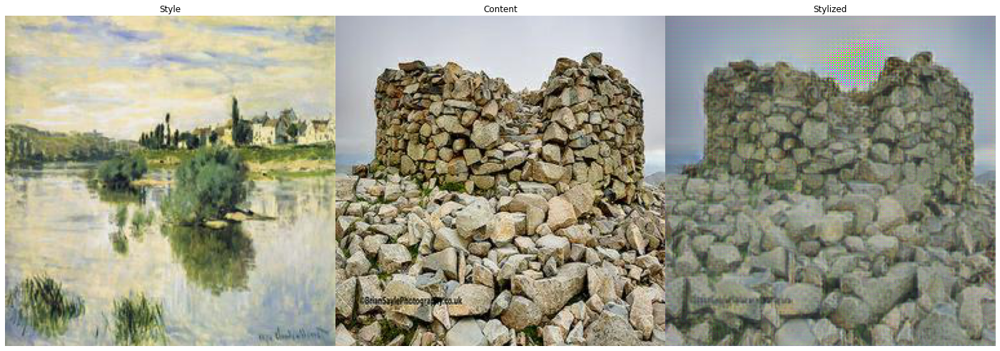

Epoch [ 3100/ 4000] | minutes since start:  17.27 | content_loss: 38.9231 | style_loss: 18.7782 | total_perceptual_loss: 57.7013
Epoch [ 3200/ 4000] | minutes since start:  17.82 | content_loss: 40.2687 | style_loss: 18.1581 | total_perceptual_loss: 58.4268
Epoch [ 3300/ 4000] | minutes since start:  18.38 | content_loss: 40.4192 | style_loss: 17.7073 | total_perceptual_loss: 58.1265
Epoch [ 3400/ 4000] | minutes since start:  18.93 | content_loss: 36.2767 | style_loss: 18.3167 | total_perceptual_loss: 54.5934
Epoch [ 3500/ 4000] | minutes since start:  19.49 | content_loss: 39.8755 | style_loss: 18.2050 | total_perceptual_loss: 58.0805
Epoch [ 3600/ 4000] | minutes since start:  20.04 | content_loss: 33.9372 | style_loss: 17.2104 | total_perceptual_loss: 51.1475
Epoch [ 3700/ 4000] | minutes since start:  20.60 | content_loss: 35.7895 | style_loss: 18.7432 | total_perceptual_loss: 54.5327
Epoch [ 3800/ 4000] | minutes since start:  21.16 | content_loss: 31.8334 | style_loss: 17.0783 |

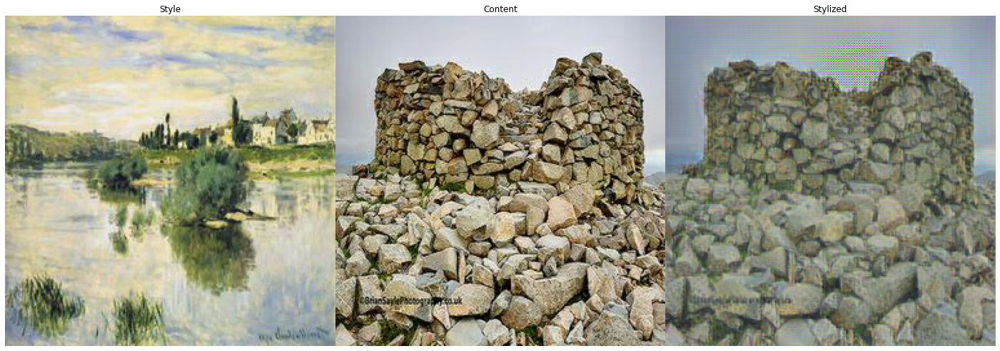

In [149]:
#Sample of one-to-many
losses = training_loop(style_img, n_epochs=4000)

In [150]:
batch_size_content = 1
content_loader_X = DataLoader(dataset_photo, batch_size=batch_size_content, shuffle=False, num_workers=0, pin_memory=True)
dataiter_content = iter(content_loader_X)
content_img_1 = dataiter_content.next()
content_img_2 = dataiter_content.next()
content_img_3 = dataiter_content.next()
content_img_4 = dataiter_content.next()
content_img_1 = content_img_1.to(device)
content_img_2 = content_img_2.to(device)
content_img_3 = content_img_3.to(device)
content_img_4 = content_img_4.to(device)

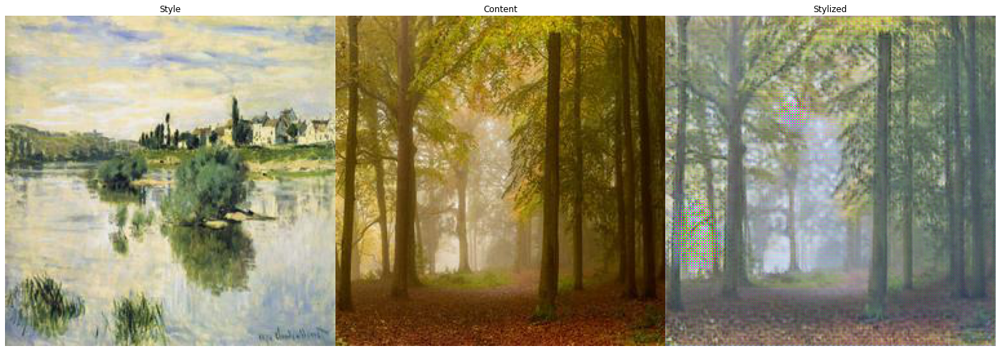

In [151]:
show_test(style_img, content_img_1, G_XtoY)

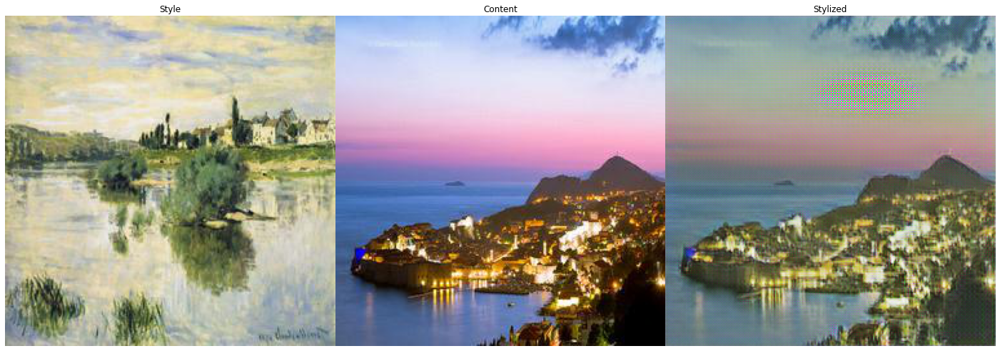

In [152]:
show_test(style_img, content_img_2, G_XtoY)

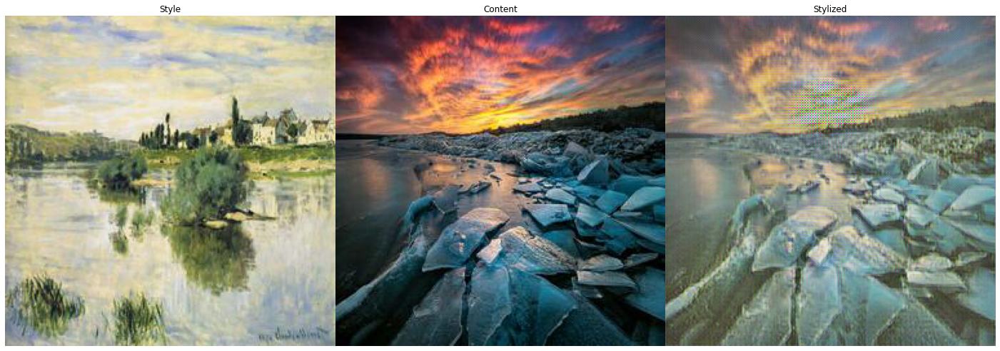

In [153]:
show_test(style_img, content_img_3, G_XtoY)

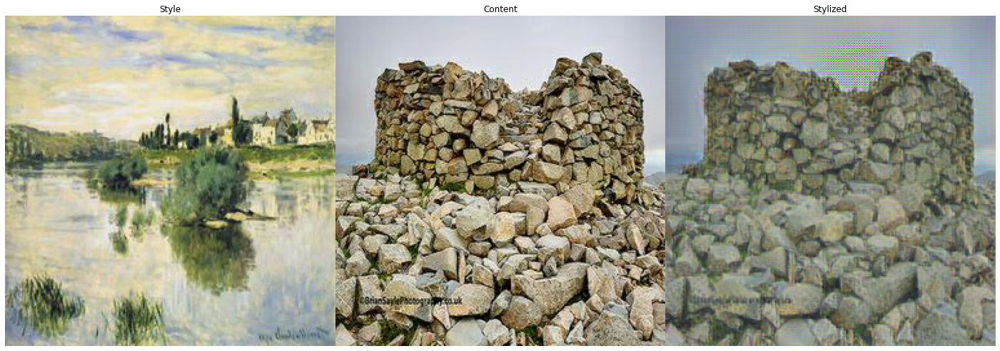

In [154]:
show_test(style_img, content_img_4, G_XtoY)